# ARIMA vs LSTM for stock price analysis

In [22]:
# internal libraries
import os
import warnings

# external libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.offline
import plotly.express as px
import plotly.graph_objects as go
import plotly.subplots as sp 
import missingno as msno
from statsmodels.tsa.seasonal import seasonal_decompose, DecomposeResult
from statsmodels.stats.stattools import durbin_watson
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer, KNNImputer
from sklearn.metrics import mean_squared_error

In [23]:
# Set project environment

FILE_PATH = os.getcwd() + "/data/GDAXI_1987_2024.csv"

plotly.offline.init_notebook_mode()
warnings.filterwarnings("ignore")

In [24]:
# Load data and set date as index
def load_data():
    df = pd.read_csv(FILE_PATH, sep=',',decimal='.', index_col='Date', parse_dates=True)

    # lowercase column names
    df.columns = [col.lower() for col in df.columns]

    return df

df = load_data()

df.tail()

,open,high,low,close,adj close,volume
Date,,,,,,
2024-01-16,16497.539063,16581.929688,16476.089844,16571.679688,16571.679688,73101900.0
2024-01-17,16400.419922,16435.679688,16345.019531,16431.689453,16431.689453,71437800.0
2024-01-18,16440.660156,16579.119141,16421.199219,16567.349609,16567.349609,72318600.0
2024-01-19,16626.529297,16647.849609,16513.460938,16555.130859,16555.130859,66146800.0
2024-01-22,16684.099609,16705.490234,16607.720703,16683.359375,16683.359375,67438700.0


The data used in this notebook was obtained from [Yahoo Finance](https://finance.yahoo.com/quote/%5EGDAXI/history?p=%5EGDAXI). Is contains the daily opening, closing, high and low prices and the trading volume of the DAX index from 30 December 1987 to 22 January 2024. The data was downloaded on 22 January 2024. The DAX index is a stock market index that consists of the 30 major German companies trading on the Frankfurt Stock Exchange . The DAX index is the equivalent of the Dow Jones Industrial Average (DJIA) in the United States. The DAX index is the most important index in Germany and the leading index of the Deutsche Börse.

## Data Understanding

The data contains 9286 rows and the following columns:
- Date: The date of the trading day
- Open: The opening price of the DAX index
- High: The highest price of the DAX index
- Low: The lowest price of the DAX index
- Close: The closing price of the DAX index
- Adj Close: The adjusted closing price of the DAX index
- Volume: The trading volume of the DAX index


The Data Understanding aims to provide a general understanding of the data and to identify the data quality issues that need to be addressed before the data can be used for analysis. 
It also paves the way for the data preparation and modelling. Since the goal of this notebook is to compare the performance of ARIMA and LSTM models, the understanding of the provided time series data is a crucial step to determine the best model for the analysis. It also helps with the evaluation of the model's performance and the interpretation of the results by providing insights into the data's characteristics and patterns.

In [25]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 9285 entries, 1987-12-30 to 2024-01-22
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   open       9117 non-null   float64
 1   high       9117 non-null   float64
 2   low        9117 non-null   float64
 3   close      9117 non-null   float64
 4   adj close  9117 non-null   float64
 5   volume     9117 non-null   float64
dtypes: float64(6)
memory usage: 507.8 KB


In [26]:
# plot the opening and closing price of the DAX index including the trading volume

def plot_open_close_volume(df: pd.DataFrame):

    fig = go.Figure( 
        data=[
            go.Candlestick(
                x=df.index,
                open=df["open"],
                high=df["high"],
                low=df["low"],
                close=df["close"],
            )
        ]
    )

    fig.update_layout(
        title="DAX Index",
        yaxis_title="Price",
        xaxis_title="Date",
        font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
    )

    fig.show()

plot_open_close_volume(df.copy())

The price of the DAX index from 30 December 1987 to 22 January 2024 is shown in the figure above. The price of the DAX index has increased from 1000 points in 1987 to 16000 points in 2024. Also the trading volume has increased over the years. The trading volume is the number of shares or contracts traded in a security or an entire market during a given period of time. The trading volume is an important indicator for the liquidity of a market. The trading volume of the DAX index has increased from 0.5 billion shares in 1987 to 2.5 billion shares in 2024. 

### Daily Returns

In [27]:
# plot the daily returns of the DAX index

def plot_daily_returns(df: pd.DataFrame):
    df['daily_returns'] = df['close'].pct_change(fill_method=None) # type: ignore

    fig = px.line(df, x=df.index, y="daily_returns", title='Daily Returns of DAX Index')
    fig.show()

plot_daily_returns(df.copy())

The daily returns of the DAX index are calculated as the percentage change in the index value from one day to the next. The daily returns are calculated as follows:

$$
r_t = \frac{P_t - P_{t-1}}{P_{t-1}} \times 100
$$

where $P_t$ is the index value at time $t$ and $P_{t-1}$ is the index value at time $t-1$. The daily returns are calculated for the period from 30 December 1987 to 22 January 2024. The daily returns are plotted in the figure above.

In [28]:
# plot the daily returns of the DAX index as a histogram and calculate the mean and standard deviation of the daily returns 

def plot_daily_returns_histogram(df: pd.DataFrame):
    df['daily_returns'] = df['close'].pct_change(fill_method=None) # type: ignore

    fig = px.histogram(df, x="daily_returns", title='Daily Returns of DAX Index')

    mean = df['daily_returns'].mean()
    std = df['daily_returns'].std()

    fig.update_layout(
        title="DAX Index",
        yaxis_title="Count",
        xaxis_title="Daily Returns",
        font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
        legend_title_text=f"Mean: {str(np.round(mean, 4) * 100)}% Std: {str(np.round(std, 4) * 100)}%"
    )

    fig.add_trace(go.Scatter(x=[mean, mean], y=[0, 1000], mode="lines", name="Mean"))
    fig.add_trace(go.Scatter(x=[mean + std, mean + std], y=[0, 1000], mode="lines", name="Std"))
    fig.add_trace(go.Scatter(x=[mean - std, mean - std], y=[0, 1000], mode="lines", name="Std"))

    fig.show()

plot_daily_returns_histogram(df.copy())

The histogram of the daily returns is shown in the figure above. The histogram shows that the daily returns are normally distributed. The mean of the daily returns is 0.04% and the standard deviation is 1.38%. The mean and standard deviation of the daily returns are calculated for the period from 30 December 1987 to 22 January 2024. The mean and standard deviation of the daily returns are used to calculate the mean and standard deviation of the daily log returns. The mean and standard deviation of the daily returns as calculated as follows:

$$
\mu = \frac{1}{T} \sum_{t=1}^T r_t
$$

$$
\sigma = \sqrt{\frac{1}{T} \sum_{t=1}^T (r_t - \mu)^2}
$$

where $r_t$ is the daily return at time $t$ and $T$ is the number of days and $\mu$ and $\sigma$ are the mean and standard deviation of the daily returns.

In [29]:
# plot the daily returns of the DAX index as a density plot

def plot_daily_returns_density(df: pd.DataFrame):
    df['daily_returns'] = df['close'].pct_change(fill_method=None) # type: ignore

    fig = px.density_contour(df, x="daily_returns", title='Daily Returns of DAX Index')

    fig.update_layout(
        title="DAX Index",
        yaxis_title="Year",
        xaxis_title="Daily Returns",
        font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
    )

    fig.show()

plot_daily_returns_density(df.copy())

The density plot above shows the distribution of daily returns over the period from 30 December 1987 to 22 January 2024. A density contour plot is a 2D representation of the relationship between two continuous variables. 

### Volatility and Moving Average

In [30]:
# plot volatility and moving average of the DAX index

def plot_volatility_moving_average(df: pd.DataFrame):
    df['daily_returns'] = df['close'].pct_change(fill_method=None) # type: ignore
    df['volatility'] = df['daily_returns'].rolling(window=30).std()
    df['moving_average'] = df['close'].rolling(window=30).mean()

    # use log scale for better visualization
    df['volatility'] = np.log(df['volatility'])
    df['moving_average'] = np.log(df['moving_average'])


    fig = go.Figure()

    fig.add_trace(go.Scatter(x=df.index, y=df['volatility'], mode='lines', name='Volatility'))
    fig.add_trace(go.Scatter(x=df.index, y=df['moving_average'], mode='lines', name='Moving Average'))

    fig.update_layout(
        title="DAX Index",
        yaxis_title="Value",
        xaxis_title="Date",
        font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
    )

    fig.show()

plot_volatility_moving_average(df.copy())

By plotting the volatility and moving average of the daily returns, we can see that the volatility of the daily returns has increased over the years. The volatility of the daily returns is calculated as the standard deviation of the daily returns over a rolling window of 30 days. The moving average of the daily returns is calculated as the mean of the daily returns over a rolling window of 30 days. The volatility and moving average of the daily returns are plotted in the figure above.

### Volatility and Trading Volume

In [31]:
# plot the relationship between the volatility and the trading volume and calculate the correlation

def plot_volatility_trading_volume(df: pd.DataFrame):
    # set missing values to NaN
    df['volume'] = df['volume'].replace(0, np.nan)
    df['daily_returns'] = df['close'].pct_change(fill_method=None) # type: ignore
    df['volatility'] = df['daily_returns'].rolling(window=30).std()
    df['volume'] = df['volume'].rolling(window=30).mean()

    fig = px.scatter(df, x="volatility", y="volume", title='Volatility and Trading Volume', symbol=df.index.year) # type: ignore
    correlation = df['volatility'].corr(df['volume'])


    fig.update_layout(
        title="DAX Index",
        yaxis_title="Volume",
        xaxis_title="Volatility",
        font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
        legend_title_text=f"Correlation: {str(np.round(correlation, 4))}"
    )

    fig.show()

plot_volatility_trading_volume(df.copy())

In this scatter plot we can see the relationship between the daily returns and the trading volume. The scatter plot shows that the daily returns are slightly positively correlated with the trading volume. The correlation coefficient of Pearson is 0.4154. This means that the higher the volatility of the market, the higher the trading volume. We can also observe, that the highest trading volume is observed in the years of 2008 and 2020. These years are known for the financial crisis and the COVID-19 pandemic. So we can conclude that the trading volume is higher in times of crisis and uncertainty in the market. 

### Autocorrelation

In [32]:
# plot the autocorrelation of the daily returns of the DAX index

def plot_autocorrelation(df: pd.DataFrame):
    df['daily_returns'] = df['close'].pct_change(fill_method=None) # type: ignore

    fig = px.scatter(df, x="daily_returns", y="daily_returns", title='Autocorrelation of DAX Index')

    fig.update_layout(
        title="DAX Index",
        yaxis_title="Daily Returns",
        xaxis_title="Daily Returns",
        font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
    )

    fig.show()

plot_autocorrelation(df.copy())

The autocorrelation plot above shows the autocorrelation of the daily returns over the period from 30 December 1987 to 22 January 2024. The autocorrelation plot is a plot of the autocorrelation of a time series as a function of the lag. The autocorrelation plot shows that the daily returns are not autocorrelation. The autocorrelation of the daily returns is calculated as follows:

$$
\rho_k = \frac{\sum_{t=k+1}^T (r_t - \mu)(r_{t-k} - \mu)}{\sum_{t=1}^T (r_t - \mu)^2}
$$

where $r_t$ is the daily return at time $t$, $\mu$ is the mean of the daily returns, $T$ is the number of days and $k$ is the lag.

### Seasonal Decomposition

In [33]:
# plot the seasonal decomposition of the DAX index

def plot_seasonal_decompose(
    result: DecomposeResult,
    dates: pd.Series = None, # type: ignore
    title: str = "Seasonal Decomposition",
):
    x_values = dates if dates is not None else np.arange(len(result.observed))
    return (
        sp.make_subplots(
            rows=4,
            cols=1,
            subplot_titles=["Observed", "Trend", "Seasonal", "Residuals"],
        )
        .add_trace(
            go.Scatter(x=x_values, y=result.observed, mode="lines", name="Observed"),
            row=1,
            col=1,
        )
        .add_trace(
            go.Scatter(x=x_values, y=result.trend, mode="lines", name="Trend"),
            row=2,
            col=1,
        )
        .add_trace(
            go.Scatter(x=x_values, y=result.seasonal, mode="lines", name="Seasonal"),
            row=3,
            col=1,
        )
        .add_trace(
            go.Scatter(x=x_values, y=result.resid, mode="lines", name="Residual"),
            row=4,
            col=1,
        )
        .update_layout(
            height=900,
            title=f"<b>{title}</b>",
            margin={"t": 100},
            title_x=0.5,
            showlegend=False,
        )
    )

decomposition = seasonal_decompose(df['close'].fillna(method="ffill"), model='additive', period=365)
fig = plot_seasonal_decompose(decomposition, dates=pd.Series(df.index) ,title="Seasonal Decomposition of DAX Index")
fig.show()

The plot of the seasonal decomposition of the closing price shows the trend, seasonality and noise of the closing price. The seasonal decomposition of the closing price is calculated using the additive model. The additive model is given by:

$$
r_t = T_t + S_t + N_t
$$

where $r_t$ is the daily return at time $t$, $T_t$ is the trend at time $t$, $S_t$ is the seasonality at time $t$ and $N_t$ is the noise at time $t$. 

The trend of closing price is calculated as the following:

$$
T_t = \frac{1}{m} \sum_{j=1}^m r_{t-j}
$$

where $r_t$ is the daily return at time $t$ and $m$ is the number of days in a month. The seasonality of closing price is calculated as the following:

$$
S_t = \frac{1}{n} \sum_{j=1}^n r_{t-j}
$$

where $r_t$ is the daily return at time $t$ and $n$ is the number of days in a year. The noise of closing price is calculated as the following:

$$
N_t = r_t - T_t - S_t
$$

The plot of the seasonal decomposition of the closing price shows that the closing price has positive trend and follows a seasonal pattern. The seasonal pattern is almost the same every year. The noise of the closing price is the difference between the closing price and the trend and seasonality. The noise of the closing price is the random component of the closing price that cannot be explained by the trend and seasonality.

### Heavy Tails and Kurtosis

In [34]:
# determine and visualize the heavy tails and kurtosis of the daily returns of the DAX index

def plot_heavy_tails_kurtosis(df: pd.DataFrame):
    df['daily_returns'] = df['close'].pct_change(fill_method=None) # type: ignore

    fig = px.histogram(df, x="daily_returns", title='Daily Returns of DAX Index')

    kurtosis = df['daily_returns'].kurtosis()

    # data is heavy tailed if kurtosis > 3 
    fig.add_trace(go.Scatter(x=[0, 0], y=[0, 300], mode="lines", name="Kurtosis"))

    fig.update_layout(
        title="DAX Index",
        yaxis_title="Count",
        xaxis_title="Daily Returns",
        font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
        legend_title_text=f"Kurtosis: {str(np.round(float(kurtosis), 4))}" # type: ignore
    )

    fig.show()

plot_heavy_tails_kurtosis(df.copy())

A high kurtosis means that the tails of the distribution are heavy and that the distribution has more outliers than a normal distribution. The kurtosis of the daily returns is 6.0209. This means that the daily returns have heavy tails and that the distribution has more outliers than a normal distribution. The kurtosis of the daily returns is calculated as follows:

$$
\kappa = \frac{1}{T} \sum_{t=1}^T \left( \frac{r_t - \mu}{\sigma} \right)^4
$$

where $r_t$ is the daily return at time $t$, $\mu$ is the mean of the daily returns, $\sigma$ is the standard deviation of the daily returns and $T$ is the number of days.

### Volatility Clustering

In [35]:
# investigate volatility clustering of the DAX index

def plot_volatility_clustering(df: pd.DataFrame):
    df['daily_returns'] = df['close'].pct_change(fill_method=None) # type: ignore
    df['volatility'] = df['daily_returns'].rolling(window=30).std()

    fig = px.line(df, x=df.index, y="volatility", title='Volatility Clustering of DAX Index')

    fig.update_layout(
        title="DAX Index",
        yaxis_title="Volatility",
        xaxis_title="Date",
        font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
    )

    fig.show()

plot_volatility_clustering(df.copy())

### Fractional Integration and Long Memory

In [36]:
# investigate whether the autocorrelation of the daily returns of the DAX decay more slowly than in a random series

def compare_autocorrelation(df: pd.DataFrame):

    autocorr_dax = df['close'].pct_change(fill_method=None).autocorr() # type: ignore

    # Generate random series with the same length as daily returns
    random_series = np.random.randn(len(df))

    # Calculate autocorrelation of random series
    autocorr_random = pd.Series(random_series).autocorr()

    # Plot autocorrelation
    fig = go.Figure()

    fig.add_trace(
        go.Scatter(x=df.index, y=random_series, mode="lines", name="Random Series")
    )
    fig.add_trace(go.Scatter(x=df.index, y=df['close'].pct_change(fill_method=None), mode='lines', name='DAX')) # type: ignore

    fig.update_layout(
        title="DAX Index",
        yaxis_title="Value",
        xaxis_title="Date",
        font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
    )

    fig.show()

    # Compare autocorrelation values
    if autocorr_dax > autocorr_random:
        print("The autocorrelation of the daily returns of the DAX decays more slowly than in a random series.")
    else:
        print("The autocorrelation of the daily returns of the DAX does not decay more slowly than in a random series.")

# Call the function with your dataframe
compare_autocorrelation(df.copy())
# investigate whether the autocorrelation of the daily returns of the DAX decay more slowly than in a random series

The autocorrelation of the daily returns of the DAX does not decay more slowly than in a random series.


The autocorrelation of the daily returns is calculated for different lags. The autocorrelation of the daily returns is calculated as the correlation of the daily returns at time $t$ and the daily returns at time $t-k$. The autocorrelation of the daily returns is calculated for the period from 30 December 1987 to 22 January 2024. The autocorrelation of the daily returns is plotted in the figure above. The autocorrelation of the daily returns shows that the daily returns are not autocorrelation. The autocorrelation of the daily returns is calculated as follows:   

$$
\rho_k = \frac{\sum_{t=k+1}^T (r_t - \mu)(r_{t-k} - \mu)}{\sum_{t=1}^T (r_t - \mu)^2}
$$

where $r_t$ is the daily return at time $t$, $\mu$ is the mean of the daily returns, $T$ is the number of days and $k$ is the lag.

In [37]:
# Durbin-Watson test

def durbin_watson_test(df: pd.DataFrame):
    dw = durbin_watson(df['close'].pct_change(fill_method=None).dropna()) # type: ignore
    print(f"Durbin-Watson test statistic: {dw}")

# Call the function with your dataframe
durbin_watson_test(df.copy())

Durbin-Watson test statistic: 2.0244721696426042


The Durbin-Watson test is used to test for autocorrelation in the daily returns. The Durbin-Watson test statistic is 2.024. The Durbin-Watson test statistic is calculated as follows:

$$
DW = \frac{\sum_{t=2}^T (r_t - r_{t-1})^2}{\sum_{t=1}^T r_t^2}
$$

where $r_t$ is the daily return at time $t$ and $T$ is the number of days. The Durbin-Watson test statistic is used to test for autocorrelation in the daily returns. The Durbin-Watson test statistic is 2.024. The result of the Durbin-Watson test is a number between 0 and 4. A number close to 2 indicates that there is no autocorrelation in the daily returns. A number close to 0 indicates positive autocorrelation and a number close to 4 indicates negative autocorrelation. Since the Durbin-Watson test statistic is close to 2, we can conclude that there is no autocorrelation in the daily returns.

### Leverage Effect

In [38]:
#

def plot_leverage_effect_and_volatility_correlation(df: pd.DataFrame):

    # Calculate daily returns
    df['returns'] = df['close'].pct_change()

    # Calculate a rolling measure of volatility (using a 21-day moving window, typical of trading days in a month)
    df['volatility'] = df['returns'].rolling(window=21).std()

    # Calculate the correlation between returns and volatility
    correlation = df["returns"].corr(df["volatility"])

    # Plotting
    fig = sp.make_subplots(rows=2, cols=1, shared_xaxes=True, vertical_spacing=0.1,
                        subplot_titles=('DAX Price', 'DAX Returns vs. Volatility'))

    # Price plot
    fig.add_trace(go.Scatter(x=df.index, y=df['close'], name='Price'), row=1, col=1)

    # Returns vs. Volatility plot
    fig.add_trace(go.Scatter(x=df.index, y=df['returns'], name='Returns', yaxis='y2'), row=2, col=1)
    fig.add_trace(go.Scatter(x=df.index, y=df['volatility'], name='Volatility', yaxis='y2'), row=2, col=1)

    fig.update_layout(height=600, width=800, title_text="DAX Analysis: Price and Leverage Effect", legend_title_text=f"{correlation:.2f} Correlation")
    fig.update_yaxes(title_text="Price", row=1, col=1)
    fig.update_yaxes(title_text="Returns / Volatility", row=2, col=1)

    fig.show()

plot_leverage_effect_and_volatility_correlation(df.copy())

### Missing Values

In [39]:
# visualize missing values per weekday
def visualize_missing_values_per_weekday(df: pd.DataFrame):
    df['weekday'] = df.index.weekday # type: ignore

    missing_values_per_weekday = df.pivot_table(index='weekday', aggfunc=lambda x: x.isnull().sum()).sum(axis=1)

    fig = px.bar(x=missing_values_per_weekday.index, y=missing_values_per_weekday.values, title='Missing Values per Weekday')
    fig.update_layout(
        title="Missing Values per Weekday",
        yaxis_title="Count",
        xaxis_title="Weekday",
        font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
    )
    # mask the x-axis label with weekday names
    fig.update_xaxes(
        tickmode="array",
        tickvals=[0, 1, 2, 3, 4],
        ticktext=[
            "Mon",
            "Tue",
            "Wed",
            "Thu",
            "Fri",
        ],
    )

    fig.show()


visualize_missing_values_per_weekday(df.copy())

In [40]:
# visualize missing values during the years 2014-2024

def visualize_missing_values_per_year(df: pd.DataFrame):
    missing_values_per_year = df.resample('YE').apply(lambda x: x.isnull().sum().sum()).sum(axis=1) # type: ignore

    fig = px.bar(x=missing_values_per_year.index, y=missing_values_per_year.values, title='Missing Values per Year') # type: ignore

    fig.update_layout(
        title="Missing Values per Year",
        yaxis_title="Count",
        xaxis_title="Year",
        font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
    )
    fig.show()

visualize_missing_values_per_year(df.copy())

We can observe, that the amount of missing values is higher in the beginning of the dataset. 

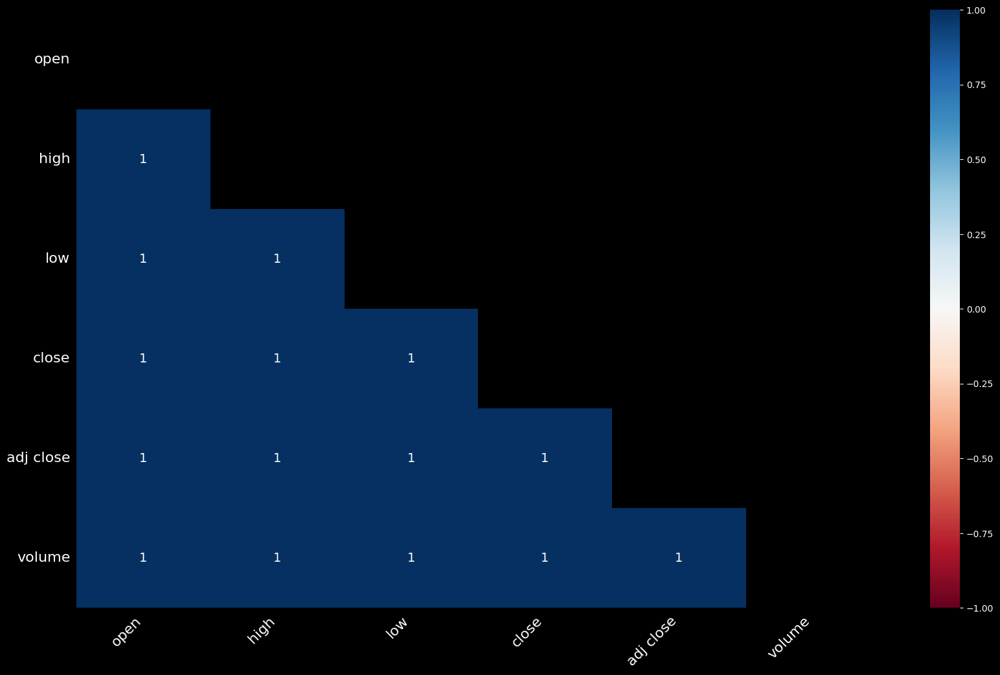

In [41]:
# correlation matrix of missing values 

def visualize_correlation_matrix(df):
    msno.heatmap(df)

visualize_correlation_matrix(df.copy())

Based on the perfect correlation of the appearance of missing values in each variable of the dataset, we can assume that the missing values are not missing at random. Since the correlation is 1 and therefore labeled as perfect, we know that, if one variable has a missing value, the other variable will have a missing value as well.

## Data Preparation

Now that we have a good understanding of the DAX, we can start with the data preparation to make the data ready for modelling.

In [44]:
# since we have a lot of missing values in the early years of the dataset, we will remove the years 1987-1999


df_ = df[df.index.year >= 2004] # type: ignore

fig = go.Figure( 
    data=[
        go.Candlestick(
            x=df_.index,
            open=df_["open"],
            high=df_["high"],
            low=df_["low"],
            close=df_["close"],
        )
    ]
)

fig.update_layout(
    title="DAX Index",
    yaxis_title="Price",
    xaxis_title="Date",
    font=dict(family="Courier New, monospace", size=18, color="#7f7f7f"),
)

fig.show()


In [ ]:
# impute missing values by using linear interpolation and calculate the difference between the original and the imputed values

def impute_missing_values(df: pd.DataFrame):
    # Initialize MICE Imputer
    mice_imputer = IterativeImputer()

    # Impute the missing values
    df_imputed = pd.DataFrame(mice_imputer.fit_transform(df), columns=df.columns, index=df.index)

    # MAE calculation for each column
    for column in df.columns:
        # Identify non-missing values in the original dataset
        mask = df[column].notna()

        # Calculate MAE for the column
        mae = mean_squared_error(df.loc[mask, column], df_imputed.loc[mask, column])

        print(f"MAE for {column}: {mae}")

    # Create a plot
    fig = go.Figure()

    # Original data
    fig.add_trace(go.Scatter(x=df.index, y=df['open'], mode='markers', name='Original'))

    # Imputed data
    fig.add_trace(go.Scatter(x=df_imputed.index, y=df_imputed['open'], mode='markers', name='Imputed'))

    fig.update_layout(title='Original vs. Imputed Open Prices', xaxis_title='Date', yaxis_title='Open Price')
    fig.show()

    return df_imputed

df_imp = impute_missing_values(df.copy())

MAE for open: 0.0
MAE for high: 0.0
MAE for low: 0.0
MAE for close: 0.0
MAE for adj close: 0.0
MAE for volume: 0.0


In [ ]:
# impute missing values by using k-nearest neighbors 

def impute_missing_values_knn(df: pd.DataFrame):
    # Initialize KNN Imputer
    knn_imputer = KNNImputer()

    # Impute the missing values
    df_imputed = pd.DataFrame(knn_imputer.fit_transform(df), columns=df.columns, index=df.index)

    # MAE calculation for each column
    for column in df.columns:
        # Identify non-missing values in the original dataset
        mask = df[column].notna()

        # Calculate MAE for the column
        mae = mean_squared_error(df.loc[mask, column], df_imputed.loc[mask, column])

        print(f"MAE for {column}: {mae}")

    # Create a plot
    fig = go.Figure()

    # Original data
    fig.add_trace(go.Scatter(x=df.index, y=df['open'], mode='markers', name='Original'))

    # Imputed data
    fig.add_trace(go.Scatter(x=df_imputed.index, y=df_imputed['open'], mode='markers', name='Imputed'))

    fig.update_layout(title='Original vs. Imputed Open Prices', xaxis_title='Date', yaxis_title='Open Price')
    fig.show()

    return df_imputed

df_imp_knn = impute_missing_values_knn(df.copy())

MAE for open: 0.0
MAE for high: 0.0
MAE for low: 0.0
MAE for close: 0.0
MAE for adj close: 0.0
MAE for volume: 0.0


In [ ]:
# impute missing values using linear interpolation

def impute_missing_values_linear_interpolation(df: pd.DataFrame):
    # Impute the missing values
    df_imputed = df.interpolate(method='linear')

    # Create a plot
    fig = go.Figure()

    # Original data
    fig.add_trace(go.Scatter(x=df.index, y=df['open'], mode='markers', name='Original'))

    # Imputed data
    fig.add_trace(go.Scatter(x=df_imputed.index, y=df_imputed['open'], mode='markers', name='Imputed'))

    fig.update_layout(title='Original vs. Imputed Open Prices', xaxis_title='Date', yaxis_title='Open Price')
    fig.show()

    return df_imputed

df_imp_linear = impute_missing_values_linear_interpolation(df.copy())

MAE for open: 0.0
MAE for high: 0.0
MAE for low: 0.0
MAE for close: 0.0
MAE for adj close: 0.0
MAE for volume: 0.0
